In [1]:
pip install mesa==2.3.3

Note: you may need to restart the kernel to use updated packages.


In [5]:
# We import the required classes to handle agents (Agent) and their environment (Model).
# Each model can contain multiple agents.
from mesa import Agent, Model

# Since we need only one agent per cell, we choose 'SingleGrid'.
from mesa.space import SingleGrid

# With 'RandomActivation', we make all agents activate 'at the same time'.
from mesa.time import RandomActivation

# We'll use 'DataCollector' to obtain information from each step of the simulation.
from mesa.datacollection import DataCollector

# We'll use matplotlib to create an animation of each model step.
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"
matplotlib.rcParams['animation.embed_limit'] = 2**128

# We import the following packages for better handling of numerical values.
import numpy as np
import pandas as pd

# We define other packages that we'll use to measure the execution time of our algorithm.
import time
import datetime

In [6]:
class Pastor(Agent):
    def __init__(self, unique_id, model):
        super().__init__(unique_id, model)
        self.carrying_sheep = False
        self.dropped_sheep = False

    def move(self):
      movements = self.model.grid.get_neighborhood(self.pos, moore=True, include_center=False)
      empty_movements = [move for move in movements if self.model.grid.is_cell_empty(move)]
      if empty_movements:
        new_position = self.random.choice(empty_movements)
        self.model.grid.move_agent(self, new_position)



    def step(self):
      (x, y) = self.pos

      if self.model.cells[x][y] == 1 and self.carrying_sheep is False and self.dropped_sheep is False: # If a sheep is found and it is not carrying anything
        self.model.cells[x][y] = 0  # Collects the sheep
        self.carrying_sheep = True

      elif self.carrying_sheep is True and self.model.cells[x][y] == 0: # If it is carrying a sheep and there is no sheep in its place
          self.move()

      elif self.carrying_sheep is True and self.model.cells[x][y] == 1: # If it is carrying a sheep and finds another one in its place
        # Leaves the sheep in a random empty place
        possible_steps = self.model.grid.get_neighborhood(self.pos, moore=True, include_center=False)

        # Tests if there is a random place to leave the sheep
        place_found = False
        for step in possible_steps:
          if self.model.cells[step[0]][step[1]] == 0:
            self.model.cells[step[0]][step[1]] = 1
            place_found = True
            self.carrying_sheep = False
            self.dropped_sheep = True
            break

        # If it doesn't find empty places around it, it moves
        if not place_found:
          self.move()

      elif self.carrying_sheep is False and self.dropped_sheep is True:
        self.dropped_sheep = False
        self.move()

      else:
        self.move()

In [7]:
def get_grid(model):
  grid = np.zeros((model.grid.width, model.grid.height))
  for content, (x, y) in model.grid.coord_iter():
    if content != None:
      grid[x][y] = 2
  return grid

In [8]:
def match_elements(model):
    grid = np.copy(model.cells)

    for agent in model.schedule.agents:
        grid[agent.pos[0], agent.pos[1]] = 2

    return grid

In [9]:

class RanchoModel(Model):
    def __init__(self, width, height, num_shepherds, num_sheep):
      super().__init__()
      self.grid = SingleGrid(width, height, torus=False)
      self.schedule = RandomActivation(self)
      self.datacollector = DataCollector(
        model_reporters={"Grid": get_grid,
                         "Match": match_elements,
                         "Steps": lambda model: model.steps,
                         "Efficiency": self.compute_efficiency}
      )


      self.steps = 0
      self.cells = np.zeros((width, height))


      # Places sheeps
      count = num_sheep
      while count > 0:
        x = self.random.randrange(width)
        y = self.random.randrange(height)
        while self.cells[x][y] != 0:
          x = self.random.randrange(width)
          y = self.random.randrange(height)
        self.cells[x][y] = 1
        count -= 1
        self.target_position = (x, y)

      # Places shepherds
      for i in range(1, num_shepherds + 1):
        x = self.random.randrange(width)
        y = self.random.randrange(height)
        if self.grid.is_cell_empty((x, y)):
          pastor = Pastor(i, self)
          self.grid.place_agent(pastor, (x, y))
          self.schedule.add(pastor)


    def compute_efficiency(self):
        empty_neighbors = 0
        total_spaces = self.grid.width * self.grid.height


        # Goes through all the spaces in the grid
        for i in range(self.grid.width):
            for j in range(self.grid.height):
                # Determines the neighbors of each space
              neighbors = self.grid.get_neighborhood((i, j), moore=True, include_center=False)
              # Checks if the neighbors are empty in the sheep matrix
              no_neighbors = True
              for neighbor in neighbors:
                if self.cells[neighbor[0]][neighbor[1]] == 1:
                  no_neighbors = False
                  break
              if no_neighbors:
                empty_neighbors += 1

        return empty_neighbors / (total_spaces - num_sheep) * 100


    def step(self):
      efficiency = self.compute_efficiency()

      if efficiency <= 90:
        self.steps += 1
        self.datacollector.collect(self)
        self.schedule.step()
      else:
        return


In [10]:
class PastorEfficient(Agent):
    def __init__(self, unique_id, model):
        super().__init__(unique_id, model)
        self.carrying_sheep = False
        self.dropped_sheep = False

    def move(self):
      movements = self.model.grid.get_neighborhood(self.pos, moore=True, include_center=False)
      empty_movements = [move for move in movements if self.model.grid.is_cell_empty(move)]
      if empty_movements:
        new_position = self.random.choice(empty_movements)
        self.model.grid.move_agent(self, new_position)

    def moveToSheep(self):
      movements = self.model.grid.get_neighborhood(self.pos, moore=True, include_center=False)
      empty_movements = [move for move in movements if self.model.grid.is_cell_empty(move)]
      # It moves prioritizing the sheep
      sheep_cells = [cell for cell in empty_movements if self.model.cells[cell[0]][cell[1]] == 1]
      if sheep_cells:
        new_position = self.random.choice(sheep_cells)
      else:
        new_position = self.random.choice(empty_movements)

      self.model.grid.move_agent(self, new_position)

    def step(self):
      (x, y) = self.pos

      if self.model.cells[x][y] == 1 and self.carrying_sheep is False and self.dropped_sheep is False: # If a sheep is found and it is not carrying anything
        self.model.cells[x][y] = 0  # Carries the sheep
        self.carrying_sheep = True

      elif self.carrying_sheep is True and self.model.cells[x][y] == 0: # If it is carrying a sheep and there is no sheep in its place
          self.move()

      elif self.carrying_sheep is True and self.model.cells[x][y] == 1: # If it is carrying a sheep and finds another one in its place
        # Leaves the sheep in a random empty place
        possible_steps = self.model.grid.get_neighborhood(self.pos, moore=True, include_center=False)

        # Tests if there is a random place to leave the sheep
        place_found = False
        for step in possible_steps:
          if self.model.cells[step[0]][step[1]] == 0:
            self.model.cells[step[0]][step[1]] = 1
            place_found = True
            self.carrying_sheep = False
            self.dropped_sheep = True
            break

        # If it doesn't find empty places around it, it moves
        if not place_found:
          self.move()

      elif self.carrying_sheep is False and self.dropped_sheep is True:
        self.dropped_sheep = False
        self.move()

      else:
        self.moveToSheep()

In [11]:

class RanchoModelEfficient(Model):
    def __init__(self, width, height, num_shepherds, num_sheep):
      super().__init__()
      self.grid = SingleGrid(width, height, torus=False)
      self.schedule = RandomActivation(self)
      self.datacollector = DataCollector(
        model_reporters={"Grid": get_grid,
                         "Match": match_elements}
      )


      self.steps = 0
      self.cells = np.zeros((width, height))


      # Places sheeps
      count = num_sheep
      while count > 0:
        x = self.random.randrange(width)
        y = self.random.randrange(height)
        while self.cells[x][y] != 0:
          x = self.random.randrange(width)
          y = self.random.randrange(height)
        self.cells[x][y] = 1
        count -= 1
        self.target_position = (x, y)

      # Places shepherds
      pastor = PastorEfficient(i, self)
      self.grid.place_agent(pastor, (10, 9))
      self.schedule.add(pastor)
      pastor = PastorEfficient(i, self)
      self.grid.place_agent(pastor, (10, 11))
      self.schedule.add(pastor)
      pastor = PastorEfficient(i, self)
      self.grid.place_agent(pastor, (10, 10))
      self.schedule.add(pastor)
      pastor = PastorEfficient(i, self)
      self.grid.place_agent(pastor, (11, 10))
      self.schedule.add(pastor)
      pastor = PastorEfficient(i, self)
      self.grid.place_agent(pastor, (9, 10))
      self.schedule.add(pastor)


    def compute_efficiency(self):
        empty_neighbors = 0
        total_spaces = self.grid.width * self.grid.height

        # Goes through all the spaces in the grid
        for i in range(self.grid.width):
            for j in range(self.grid.height):
              # Determines the neighbors of each space
              neighbors = self.grid.get_neighborhood((i, j), moore=True, include_center=False)
              # Checks if the neighbors are empty in the sheep matrix
              no_neighbors = True
              for neighbor in neighbors:
                if self.cells[neighbor[0]][neighbor[1]] == 1:
                  no_neighbors = False
                  break
              if no_neighbors:
                empty_neighbors += 1

        return empty_neighbors / (total_spaces - num_sheep) * 100


    def step(self):
      efficiency = self.compute_efficiency()

      if efficiency <= 90:
        self.steps += 1
        self.datacollector.collect(self)
        self.schedule.step()
      else:
        return


In [8]:
# Parameters
width = 20
height = 20
num_shepherds = 5
num_sheep = 150

model = RanchoModel(width, height, num_shepherds, num_sheep)
while model.compute_efficiency() < 90:
  model.step()
print("Efficiency:", model.compute_efficiency())


results = model.datacollector.get_model_vars_dataframe()
print(results)

Efficiency: 90.0
                                                   Grid  \
0     [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
1     [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
2     [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
3     [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
4     [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
...                                                 ...   
4607  [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
4608  [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
4609  [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
4610  [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   
4611  [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...   

                                                  Match  Steps  Efficiency  
0     [[1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0,...      1         4.0  
1     [[1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0,...      2         4.0  
2     [[1.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 

In [9]:
all_grids = model.datacollector.get_model_vars_dataframe()["Match"]
all_grids.info()

<class 'pandas.core.series.Series'>
RangeIndex: 4612 entries, 0 to 4611
Series name: Match
Non-Null Count  Dtype 
--------------  ----- 
4612 non-null   object
dtypes: object(1)
memory usage: 36.2+ KB


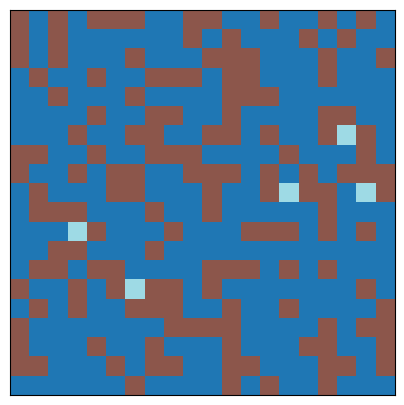

In [10]:
fig, axs = plt.subplots(figsize=(5, 5))
axs.set_xticks([])
axs.set_yticks([])
patch = plt.imshow(all_grids.iloc[0], cmap=plt.cm.tab20)

In [11]:
def animate(i):
  patch.set_data(all_grids.iloc[i])

anim = animation.FuncAnimation(fig, animate, frames=model.steps)
anim

In [12]:
width = 20
height = 20
num_shepherds = 5
num_sheep = 150
naive_efficiency_list = []

for i in range(20):
  model = RanchoModel(width, height, num_shepherds, num_sheep)
  while model.compute_efficiency() < 90: # Call the method to get the efficiency value
    model.step()
  naive_efficiency_list.append(model.steps)

print(naive_efficiency_list)

avg = 0
for elem in naive_efficiency_list:
  avg += elem
avg /= len(naive_efficiency_list)
print(avg)

[6693, 5700, 4754, 7081, 9129, 5560, 6921, 8678, 9501, 7193, 6102, 10008, 9329, 7526, 4497, 12730, 9082, 7288, 5601, 14010]
7869.15


In [24]:

width = 20
height = 20
num_shepherds = 5
num_sheep = 150
good_efficiency_list = []

for i in range(20):
  model = RanchoModelEfficient(width, height, num_shepherds, num_sheep)
  while model.compute_efficiency() < 90: # Call the method to get the efficiency value
    model.step()
  good_efficiency_list.append(model.steps)

print(good_efficiency_list)

avg_efficient = 0
for elem in good_efficiency_list:
  avg_efficient += elem
avg_efficient /= len(good_efficiency_list)
print(avg_efficient)

[6183, 7939, 6452, 9311, 8495, 5964, 6702, 3825, 4610, 5263, 10466, 13387, 4001, 4004, 8091, 7818, 5104, 13175, 8571, 6530]
7294.55


In [3]:
# Determinar el porcentaje de reduccion de pasos
reduction = (1 - avg_efficient / avg) * 100
print("Step reduction percentage:",reduction)

NameError: name 'avg_efficient' is not defined